<a href="https://colab.research.google.com/github/Shyam7407/Trazmeo_assignment1/blob/main/Assignment1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# I) python code which returns a line graph of the record high and record low temperatures by day of the year over the period 2005-2014. The area between the record high and record low temperatures for each day should be shaded.

In [37]:
import pandas as pd
import io

# Upload and read the data
from google.colab import files
uploaded = files.upload()
filename = list(uploaded.keys())[0]
df = pd.read_csv(io.BytesIO(uploaded[filename]))

# Convert 'Date' to datetime and extract components
df['Date'] = pd.to_datetime(df['Date'])
df['year'] = df['Date'].dt.year
df['month'] = df['Date'].dt.month
df['day'] = df['Date'].dt.day
df['month_day'] = df['Date'].dt.strftime('%m-%d')

# Remove leap day
df = df[~((df['month'] == 2) & (df['day'] == 29))]

print(df.head())

Saving temperature.csv to temperature (5).csv
            ID       Date Element  Data_Value  year  month  day month_day
0  USW00094889 2014-11-12    TMAX          22  2014     11   12     11-12
1  USC00208972 2009-04-29    TMIN          56  2009      4   29     04-29
2  USC00200032 2008-05-26    TMAX         278  2008      5   26     05-26
3  USC00205563 2005-11-11    TMAX         139  2005     11   11     11-11
4  USC00200230 2014-02-27    TMAX        -106  2014      2   27     02-27


In [38]:
# Filter for years 2005 to 2014
historical_df = df[(df['year'] >= 2005) & (df['year'] <= 2014)]

print(historical_df.head())


            ID       Date Element  Data_Value  year  month  day month_day
0  USW00094889 2014-11-12    TMAX          22  2014     11   12     11-12
1  USC00208972 2009-04-29    TMIN          56  2009      4   29     04-29
2  USC00200032 2008-05-26    TMAX         278  2008      5   26     05-26
3  USC00205563 2005-11-11    TMAX         139  2005     11   11     11-11
4  USC00200230 2014-02-27    TMAX        -106  2014      2   27     02-27


In [39]:
record_high = historical_df[historical_df['Element'] == 'TMAX'].groupby('month_day')['Data_Value'].max()
record_low = historical_df[historical_df['Element'] == 'TMIN'].groupby('month_day')['Data_Value'].min()

print(record_high.head(), record_low.head())

month_day
01-01    156
01-02    139
01-03    133
01-04    106
01-05    128
Name: Data_Value, dtype: int64 month_day
01-01   -160
01-02   -267
01-03   -267
01-04   -261
01-05   -150
Name: Data_Value, dtype: int64


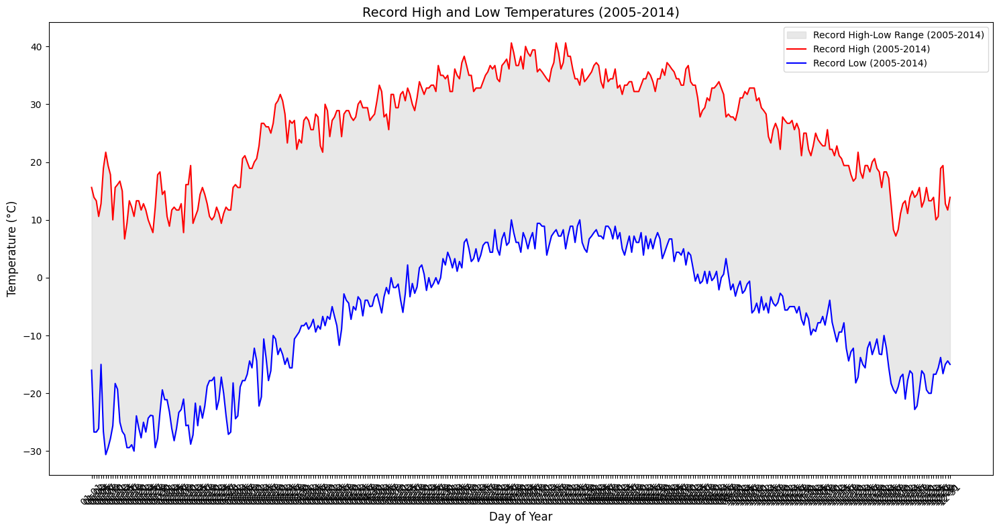

In [40]:
import matplotlib.pyplot as plt

# Plotting the high and low records
plt.figure(figsize=(15, 8))

# Shaded area between high and low
plt.fill_between(record_high.index, record_low.values/10, record_high.values/10,
                 color='lightgray', alpha=0.5, label='Record High-Low Range (2005-2014)')

# Plot high and low lines
plt.plot(record_high.index, record_high.values/10, color='red', label='Record High (2005-2014)')
plt.plot(record_low.index, record_low.values/10, color='blue', label='Record Low (2005-2014)')

# Formatting the graph
plt.xticks(rotation=45, fontsize=10)
plt.xlabel('Day of Year', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.title('Record High and Low Temperatures (2005-2014)', fontsize=14)
plt.legend(loc='best')
plt.tight_layout()
plt.show()


# II) Scatter of the 2015 data for any points (highs and lows) for which the ten year record (2005-2014) record high or record low was broken in 2015

In [42]:
import pandas as pd

# Load the dataset
from google.colab import files
uploaded=files.upload()

# Assuming your dataframe is named df
# and the date column is named 'Date' not 'date'.
# Convert 'Date' to datetime
df['Date'] = pd.to_datetime(df['Date'])

# Extract year, month, and day
df['year'] = df['Date'].dt.year
df['month_day'] = df['Date'].dt.strftime('%m-%d')

# Remove leap days (Feb 29)
df = df[df['month_day'] != '02-29']

# Preview data
print(df.head())


Saving temperature.csv to temperature (7).csv
            ID       Date Element  Data_Value  year  month  day month_day
0  USW00094889 2014-11-12    TMAX          22  2014     11   12     11-12
1  USC00208972 2009-04-29    TMIN          56  2009      4   29     04-29
2  USC00200032 2008-05-26    TMAX         278  2008      5   26     05-26
3  USC00205563 2005-11-11    TMAX         139  2005     11   11     11-11
4  USC00200230 2014-02-27    TMAX        -106  2014      2   27     02-27


In [84]:
# Historical data: 2005-2014
# Assuming your dataframe is named df
# and the date column is named 'Date' not 'date'.
# Convert 'Date' to datetime
df['Date'] = pd.to_datetime(df['Date'])

# Extract year, month, and day
df['year'] = df['Date'].dt.year
df['month_day'] = df['Date'].dt.strftime('%m-%d')

# Remove leap days (Feb 29)
df = df[df['month_day'] != '02-29']

# Preview data
print(df.head())

# Verify if the 'year' column exists
print(df.columns)

# Define historical_df before using it
historical_df = df[(df['year'] >= 2005) & (df['year'] <= 2014)]

# Record highs and lows
# Changed 'element' to 'Element' and 'value' to 'Data_Value'
record_high = historical_df[historical_df['Element'] == 'TMAX'].groupby('month_day')['Data_Value'].max()
record_low = historical_df[historical_df['Element'] == 'TMIN'].groupby('month_day')['Data_Value'].min()

# Convert to DataFrame for easier merge later
record_high_df = record_high.reset_index().rename(columns={'Data_Value': 'record_high'})
record_low_df = record_low.reset_index().rename(columns={'Data_Value': 'record_low'})

            ID       Date Element  Data_Value  Year    DOY  year month_day
0  USW00094889 2014-11-12    TMAX          22  2014  11-12  2014     11-12
1  USC00208972 2009-04-29    TMIN          56  2009  04-29  2009     04-29
2  USC00200032 2008-05-26    TMAX         278  2008  05-26  2008     05-26
3  USC00205563 2005-11-11    TMAX         139  2005  11-11  2005     11-11
4  USC00200230 2014-02-27    TMAX        -106  2014  02-27  2014     02-27
Index(['ID', 'Date', 'Element', 'Data_Value', 'Year', 'DOY', 'year',
       'month_day'],
      dtype='object')


In [50]:
# Filter 2015 TMAX and TMIN
# Changed 'element' to 'Element'
tmax_2015 = df_2015[df_2015['Element'] == 'TMAX']
tmin_2015 = df_2015[df_2015['Element'] == 'TMIN']

# Merge 2015 TMAX with record high
tmax_merged = pd.merge(tmax_2015, record_high_df, on='month_day')
# Find where 2015 TMAX exceeds historical record high
# Changed 'value' to 'Data_Value' to match the column name
tmax_broken = tmax_merged[tmax_merged['Data_Value'] > tmax_merged['record_high']]

# Merge 2015 TMIN with record low
tmin_merged = pd.merge(tmin_2015, record_low_df, on='month_day')
# Find where 2015 TMIN is lower than historical record low
# Changed 'value' to 'Data_Value' to match the column name
tmin_broken = tmin_merged[tmin_merged['Data_Value'] < tmin_merged['record_low']]

# Preview broken records
print(f"Record-breaking high temperatures in 2015:\n{tmax_broken.head()}")
print(f"Record-breaking low temperatures in 2015:\n{tmin_broken.head()}")

Record-breaking high temperatures in 2015:
              ID       Date Element  Data_Value  year  month  day month_day  \
19   USC00200228 2015-12-13    TMAX         167  2015     12   13     12-13   
26   USC00201250 2015-12-23    TMAX         167  2015     12   23     12-23   
97   USW00014833 2015-12-13    TMAX         161  2015     12   13     12-13   
183  USC00202308 2015-12-13    TMAX         178  2015     12   13     12-13   
206  USC00201250 2015-12-12    TMAX         172  2015     12   12     12-12   

     record_high  
19           111  
26           133  
97           111  
183          111  
206          133  
Record-breaking low temperatures in 2015:
               ID       Date Element  Data_Value  year  month  day month_day  \
332   USW00094889 2015-08-28    TMIN          56  2015      8   28     08-28   
689   USW00014833 2015-01-05    TMIN        -155  2015      1    5     01-05   
703   USW00094889 2015-10-17    TMIN         -55  2015     10   17     10-17   
1004  

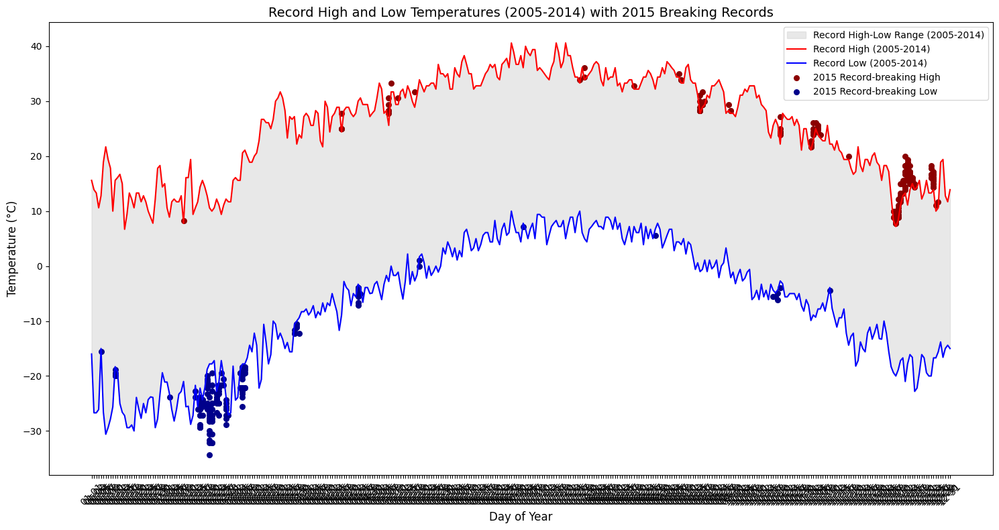

In [52]:
import matplotlib.pyplot as plt

# Plot record high and low
plt.figure(figsize=(15, 8))

# Shaded area between record high and low
plt.fill_between(record_high_df['month_day'],
                 record_low_df['record_low'] / 10,
                 record_high_df['record_high'] / 10,
                 color='lightgray', alpha=0.5, label='Record High-Low Range (2005-2014)')

# Plot high and low lines
plt.plot(record_high_df['month_day'], record_high_df['record_high'] / 10, color='red', label='Record High (2005-2014)')
plt.plot(record_low_df['month_day'], record_low_df['record_low'] / 10, color='blue', label='Record Low (2005-2014)')

# Scatter for 2015 record-breaking highs
# Changed 'value' to 'Data_Value'
plt.scatter(tmax_broken['month_day'], tmax_broken['Data_Value'] / 10, color='darkred', s=30, label='2015 Record-breaking High')

# Scatter for 2015 record-breaking lows
# Changed 'value' to 'Data_Value'
plt.scatter(tmin_broken['month_day'], tmin_broken['Data_Value'] / 10, color='darkblue', s=30, label='2015 Record-breaking Low')

# Formatting
plt.xticks(rotation=45, fontsize=10)
plt.xlabel('Day of Year', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.title('Record High and Low Temperatures (2005-2014) with 2015 Breaking Records', fontsize=14)
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# III) Watch out for leap days (i.e. February 29th), it is reasonable to remove these points from the dataset for the purpose of this visualization.  

In [54]:
import pandas as pd

# Load data
from google.colab import files
uploaded=files.upload()

# Convert 'date' to datetime
df['Date'] = pd.to_datetime(df['Date'])

# Extract month and day as 'MM-DD'
df['month_day'] = df['Date'].dt.strftime('%m-%d')

# Preview
print(df[['Date', 'month_day']].head())


Saving temperature.csv to temperature (9).csv
        Date month_day
0 2014-11-12     11-12
1 2009-04-29     04-29
2 2008-05-26     05-26
3 2005-11-11     11-11
4 2014-02-27     02-27


In [56]:
# Remove Feb 29th (Leap Day)
df = df[df['month_day'] != '02-29']

# Check if Feb 29 still exists (it shouldn't now)
print(df[df['month_day'] == '02-29'])  # Should return empty DataFrame

Empty DataFrame
Columns: [ID, Date, Element, Data_Value, year, month, day, month_day]
Index: []


In [57]:
# Historical data from 2005 to 2014
historical_df = df[(df['year'] >= 2005) & (df['year'] <= 2014)]

# Data for 2015
df_2015 = df[df['year'] == 2015]

# Quick check on both datasets
print("Historical Data:", historical_df.shape)
print("2015 Data:", df_2015.shape)


Historical Data: (151245, 8)
2015 Data: (13757, 8)


In [60]:
# Record highs (TMAX) and lows (TMIN)
# Changed 'value' to 'Data_Value' to match the actual column name in your DataFrame.
record_high = historical_df[historical_df['Element'] == 'TMAX'].groupby('month_day')['Data_Value'].max()
record_low = historical_df[historical_df['Element'] == 'TMIN'].groupby('month_day')['Data_Value'].min()

# Convert to DataFrames
# Changed 'value' to 'Data_Value' to reflect the change in the previous lines.
record_high_df = record_high.reset_index().rename(columns={'Data_Value': 'record_high'})
record_low_df = record_low.reset_index().rename(columns={'Data_Value': 'record_low'})

# Preview
print(record_high_df.head())
print(record_low_df.head())

  month_day  record_high
0     01-01          156
1     01-02          139
2     01-03          133
3     01-04          106
4     01-05          128
  month_day  record_low
0     01-01        -160
1     01-02        -267
2     01-03        -267
3     01-04        -261
4     01-05        -150


In [64]:
# 2015 TMAX and TMIN separated
tmax_2015 = df_2015[df_2015['Element'] == 'TMAX']
tmin_2015 = df_2015[df_2015['Element'] == 'TMIN']

# Merge TMAX 2015 with record highs
tmax_merged = pd.merge(tmax_2015, record_high_df, on='month_day')
# Find where 2015 TMAX exceeds historical record high
# Changed 'value' to 'Data_Value'
tmax_broken = tmax_merged[tmax_merged['Data_Value'] > tmax_merged['record_high']]

# Merge TMIN 2015 with record lows
tmin_merged = pd.merge(tmin_2015, record_low_df, on='month_day')
# Find where 2015 TMIN is lower than historical record low
# Changed 'value' to 'Data_Value'
tmin_broken = tmin_merged[tmin_merged['Data_Value'] < tmin_merged['record_low']]

# Preview results
print("2015 record-breaking highs:\n", tmax_broken.head())
print("2015 record-breaking lows:\n", tmin_broken.head())

2015 record-breaking highs:
               ID       Date Element  Data_Value  year  month  day month_day  \
19   USC00200228 2015-12-13    TMAX         167  2015     12   13     12-13   
26   USC00201250 2015-12-23    TMAX         167  2015     12   23     12-23   
97   USW00014833 2015-12-13    TMAX         161  2015     12   13     12-13   
183  USC00202308 2015-12-13    TMAX         178  2015     12   13     12-13   
206  USC00201250 2015-12-12    TMAX         172  2015     12   12     12-12   

     record_high  
19           111  
26           133  
97           111  
183          111  
206          133  
2015 record-breaking lows:
                ID       Date Element  Data_Value  year  month  day month_day  \
332   USW00094889 2015-08-28    TMIN          56  2015      8   28     08-28   
689   USW00014833 2015-01-05    TMIN        -155  2015      1    5     01-05   
703   USW00094889 2015-10-17    TMIN         -55  2015     10   17     10-17   
1004  USC00207308 2015-10-20    TM

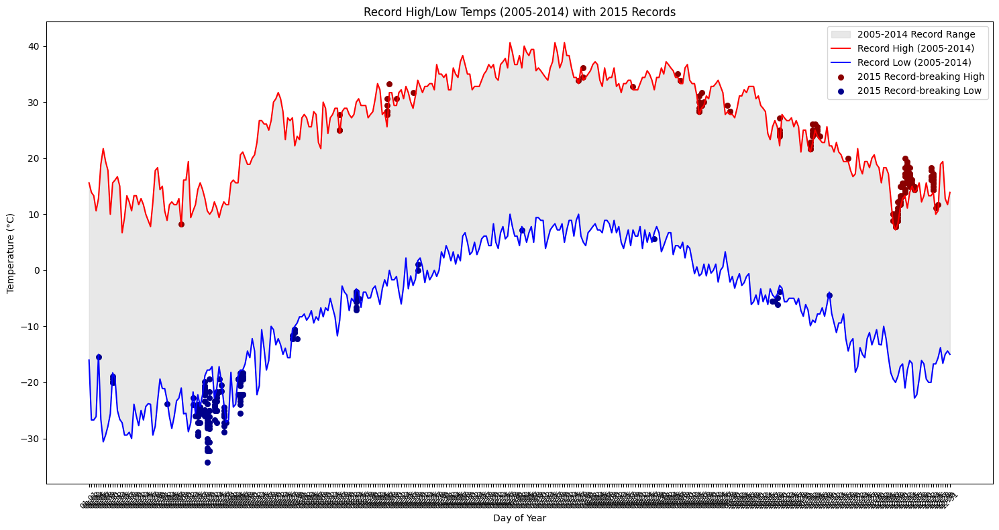

In [66]:
import matplotlib.pyplot as plt

# Plot record highs and lows
plt.figure(figsize=(15, 8))

# Shaded area between high and low
plt.fill_between(record_high_df['month_day'],
                 record_low_df['record_low'] / 10,
                 record_high_df['record_high'] / 10,
                 color='lightgray', alpha=0.5, label='2005-2014 Record Range')

# Plot high and low lines
plt.plot(record_high_df['month_day'], record_high_df['record_high'] / 10, color='red', label='Record High (2005-2014)')
plt.plot(record_low_df['month_day'], record_low_df['record_low'] / 10, color='blue', label='Record Low (2005-2014)')

# Overlay 2015 record-breaking points
# Changed 'value' to 'Data_Value' to match the column name in your DataFrame
plt.scatter(tmax_broken['month_day'], tmax_broken['Data_Value'] / 10, color='darkred', s=30, label='2015 Record-breaking High')
plt.scatter(tmin_broken['month_day'], tmin_broken['Data_Value'] / 10, color='darkblue', s=30, label='2015 Record-breaking Low')

# Formatting
plt.xlabel('Day of Year')
plt.ylabel('Temperature (°C)')
plt.title('Record High/Low Temps (2005-2014) with 2015 Records')
plt.xticks(rotation=45, fontsize=8)
plt.legend(loc='best')
plt.tight_layout()
plt.show()

# IV) Consider issues such as legends, labels, and chart junk.

In [54]:
# ✅ STEP 1: Import Libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

from google.colab import files
uploaded=files.upload()


Saving temperature.csv to temperature (1).csv


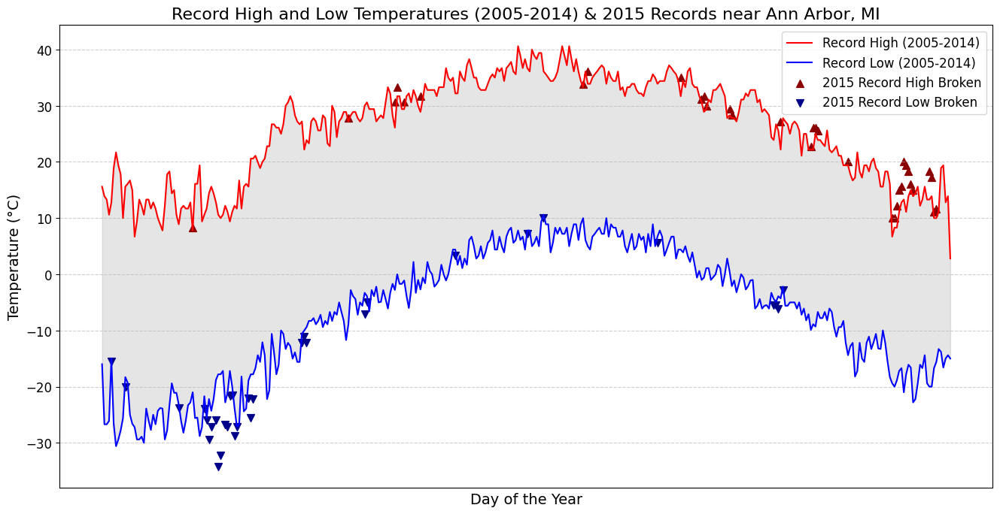

In [68]:
import io
df=pd.read_csv(io.BytesIO(uploaded[list(uploaded.keys())[0]]))# Use io.BytesIO for uploaded files

# Extract the year from the 'Date' column
# and create a new 'Year' column
df['Date'] = pd.to_datetime(df['Date']) # Convert 'Date' column to datetime
df['Year'] = df['Date'].dt.year # Extract year and create 'Year' column
df['DOY'] = df['Date'].dt.dayofyear  # Create 'DOY' column (Day of Year)

# Now you can proceed with your original code:
historical = df[(df['Year'] >= 2005) & (df['Year'] <= 2014)]
data_2015 = df[df['Year'] == 2015]
# ✅ STEP 4: Split Data: 2005-2014 (historical) and 2015 (target)
historical = df[(df['Year'] >= 2005) & (df['Year'] <= 2014)]
data_2015 = df[df['Year'] == 2015] #Changed 'temperature_df' to 'df'

# ✅ STEP 5: Compute Daily Record High/Low (2005-2014)
# Changed 'value' to 'Data_Value' to match the actual column name in the DataFrame
record_highs = historical[historical['Element'] == 'TMAX'].groupby('DOY')['Data_Value'].max()
record_lows = historical[historical['Element'] == 'TMIN'].groupby('DOY')['Data_Value'].min()

# ✅ STEP 6: Identify 2015 records that broke historical data
# Changed 'value' to 'Data_Value' to match the actual column name in the DataFrame
tmax_2015 = data_2015[data_2015['Element'] == 'TMAX'].groupby('DOY')['Data_Value'].max()
tmin_2015 = data_2015[data_2015['Element'] == 'TMIN'].groupby('DOY')['Data_Value'].min()

# Reindex tmax_2015 and tmin_2015 to match record_highs and record_lows
tmax_2015 = tmax_2015.reindex(record_highs.index)
tmin_2015 = tmin_2015.reindex(record_lows.index)

broken_highs_2015 = tmax_2015[tmax_2015 > record_highs]
broken_lows_2015 = tmin_2015[tmin_2015 < record_lows]

# STEP 7: Prepare x-axis (days of the year)
days = np.arange(len(record_highs))  # Index-based x-axis

# STEP 8: Plot
plt.figure(figsize=(16, 8))

# Plot record high and low
plt.plot(days, record_highs.values / 10, '-', color='red', label='Record High (2005-2014)')
plt.plot(days, record_lows.values / 10, '-', color='blue', label='Record Low (2005-2014)')

# Shade between highs and lows
plt.fill_between(days, record_highs.values / 10, record_lows.values / 10, color='gray', alpha=0.2)

# Scatter 2015 broken records
plt.scatter(broken_highs_2015.index.map(lambda x: list(record_highs.index).index(x)),
            broken_highs_2015.values / 10, color='darkred', label='2015 Record High Broken', s=50, marker='^')

plt.scatter(broken_lows_2015.index.map(lambda x: list(record_lows.index).index(x)),
            broken_lows_2015.values / 10, color='darkblue', label='2015 Record Low Broken', s=50, marker='v')

# ✅ STEP 9: Formatting and Labels
plt.title('Record High and Low Temperatures (2005-2014) & 2015 Records near Ann Arbor, MI', fontsize=16)
plt.xlabel('Day of the Year', fontsize=14)
plt.ylabel('Temperature (°C)', fontsize=14)
plt.legend(loc='best', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Optional: Remove x-axis ticks for simplicity or add month labels (can be added if needed)
plt.xticks([])  # Remove ticks to avoid clutter
plt.yticks(fontsize=12)

# ✅ STEP 10: Show plot
plt.show()


# V) Visualization on map the stations the data.

In [6]:
from google.colab import files
uploaded=files.upload()


Saving BinSize.csv to BinSize.csv


In [12]:
import pandas as pd
import io

# Assuming your data file has headers (column names)
df = pd.read_csv(io.BytesIO(uploaded[list(uploaded.keys())[0]])) # Use io.BytesIO for uploaded files

# Check if the 'ID' column exists
print(df.columns)

# If 'id' column is not present or named differently, adjust accordingly:
# Example: If the column is named 'ID'
df = df.rename(columns={'ID': 'ID'})

# Now proceed with the rest of your code
stations = df[['ID']].drop_duplicates()

# Load BinSize.csv into Bin_df
Bin_df = pd.read_csv(io.BytesIO(uploaded['BinSize.csv']))

# Merge with station location data
stations = pd.merge(stations, Bin_df, on='ID', how='left')

# Check if merge worked (and we got lat/lon)
print(stations.head())

Index(['ID', 'LATITUDE', 'LONGITUDE', 'ELEVATION', 'STATE', 'NAME', 'GSNFLAG',
       'HCNFLAG', 'WMOID', 'x', 'y', 'x_group', 'y_group', 'xy_group', 'hash'],
      dtype='object')
            ID  LATITUDE  LONGITUDE  ELEVATION STATE                 NAME  \
0  AE000041196    25.333     55.517       34.0   NaN  SHARJAH INTER. AIRP   
1  AEM00041194    25.255     55.364       10.4   NaN           DUBAI INTL   
2  AEM00041217    24.433     54.651       26.8   NaN       ABU DHABI INTL   
3  AEM00041218    24.262     55.609      264.9   NaN          AL AIN INTL   
4  AFM00040990    31.500     65.850     1010.0   NaN     KANDAHAR AIRPORT   

  GSNFLAG HCNFLAG    WMOID             x             y  \
0     GSN     NaN  41196.0  5.579578e+06  2.816905e+06   
1     NaN     NaN  41194.0  5.567782e+06  2.808232e+06   
2     NaN     NaN  41217.0  5.532707e+06  2.716829e+06   
3     NaN     NaN  41218.0  5.637301e+06  2.697815e+06   
4     NaN     NaN  40990.0  6.243199e+06  3.502645e+06   

       

In [36]:
import folium
import pandas as pd
import branca

# Center map around Ann Arbor, Michigan
ann_arbor_coords = [42.2808, -83.7430]

# Initialize the map
m = folium.Map(location=ann_arbor_coords, zoom_start=8)

# Add station markers
# Check if column names are 'LATITUDE' and 'LONGITUDE' or 'latitude' and 'longitude'
latitude_col = 'LATITUDE' if 'LATITUDE' in stations.columns else 'latitude'
longitude_col = 'LONGITUDE' if 'LONGITUDE' in stations.columns else 'longitude'

for idx, row in stations.iterrows():
    try:
        if pd.notnull(row[latitude_col]) and pd.notnull(row[longitude_col]):
            folium.Marker(
                location=[row[latitude_col], row[longitude_col]],
                popup=f"Station ID: {row['ID']}",
                icon=folium.Icon(color='blue', icon='cloud')
            ).add_to(m)
    except Exception as e:
        print(f"Error adding marker for station {row['ID']}: {e}")

# Save the map to an HTML string
html_string = m._repr_html_()  # Get the HTML content

# Display the HTML using IFrame (to enforce rendering within the notebook)
from IPython.display import HTML, IFrame
# Embed the HTML within the notebook
HTML(html_string)

# # Alternative: Display using IFrame
# IFrame(io.StringIO(html_string), width=800, height=600)

# # Or, still save to a file (optional):
# map_filename = 'Ann_Arbor_Stations_Map.html'
# m.save(map_filename)
# print(f"Map saved to {map_filename}")
# from IPython.display import FileLink
# FileLink(map_filename)


# VI) Plot Temperature Summary near Ann Arbor, Michigan, United States (Year 2015).

In [80]:
# ✅ STEP 1: Import Libraries
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import io # Import io for handling uploaded files


from google.colab import files
uploaded=files.upload()

Saving temperature.csv to temperature (5).csv


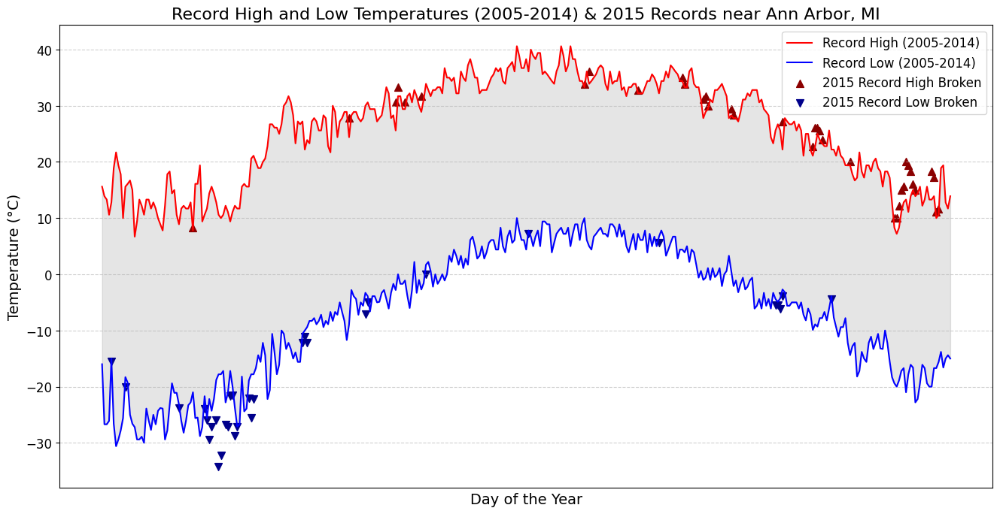

In [82]:

# ✅ STEP 2: Load Data
# Load the CSV into temperature_df
temperature_df = pd.read_csv(io.BytesIO(uploaded[list(uploaded.keys())[0]])) # Use io.BytesIO for uploaded files

# ✅ STEP 3: Data Preparation
# Convert 'Date' to datetime and drop leap day (Feb 29)
temperature_df['Date'] = pd.to_datetime(temperature_df['Date'], format='%Y-%m-%d')
temperature_df = temperature_df[~((temperature_df['Date'].dt.month == 2) & (temperature_df['Date'].dt.day == 29))]

# Extract year and day of year (DOY)
temperature_df['Year'] = temperature_df['Date'].dt.year
temperature_df['DOY'] = temperature_df['Date'].dt.strftime('%m-%d')  # 'MM-DD' for easy grouping

# ✅ STEP 4: Split Data: 2005-2014 (historical) and 2015 (target)
historical = temperature_df[(temperature_df['Year'] >= 2005) & (temperature_df['Year'] <= 2014)]
data_2015 = temperature_df[temperature_df['Year'] == 2015]

# ✅ STEP 5: Compute Daily Record High/Low (2005-2014)
# Changed 'value' to 'Data_Value' to match the actual column name in the DataFrame
record_highs = historical[historical['Element'] == 'TMAX'].groupby('DOY')['Data_Value'].max()
record_lows = historical[historical['Element'] == 'TMIN'].groupby('DOY')['Data_Value'].min()

# ✅ STEP 6: Identify 2015 records that broke historical data
# Changed 'value' to 'Data_Value' to match the actual column name in the DataFrame
tmax_2015 = data_2015[data_2015['Element'] == 'TMAX'].groupby('DOY')['Data_Value'].max()
tmin_2015 = data_2015[data_2015['Element'] == 'TMIN'].groupby('DOY')['Data_Value'].min()

broken_highs_2015 = tmax_2015[tmax_2015 > record_highs]
broken_lows_2015 = tmin_2015[tmin_2015 < record_lows]

# ✅ STEP 7: Prepare x-axis (days of the year)
days = np.arange(len(record_highs))  # Index-based x-axis

# ✅ STEP 8: Plot
plt.figure(figsize=(16, 8))

# Plot record high and low
plt.plot(days, record_highs.values / 10, '-', color='red', label='Record High (2005-2014)')
plt.plot(days, record_lows.values / 10, '-', color='blue', label='Record Low (2005-2014)')

# Shade between highs and lows
plt.fill_between(days, record_highs.values / 10, record_lows.values / 10, color='gray', alpha=0.2)

# Scatter 2015 broken records
plt.scatter(broken_highs_2015.index.map(lambda x: list(record_highs.index).index(x)),
            broken_highs_2015.values / 10, color='darkred', label='2015 Record High Broken', s=50, marker='^')

plt.scatter(broken_lows_2015.index.map(lambda x: list(record_lows.index).index(x)),
            broken_lows_2015.values / 10, color='darkblue', label='2015 Record Low Broken', s=50, marker='v')

# ✅ STEP 9: Formatting and Labels
plt.title('Record High and Low Temperatures (2005-2014) & 2015 Records near Ann Arbor, MI', fontsize=16)
plt.xlabel('Day of the Year', fontsize=14)
plt.ylabel('Temperature (°C)', fontsize=14)
plt.legend(loc='best', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Optional: Remove x-axis ticks for simplicity or add month labels (can be added if needed)
plt.xticks([])  # Remove ticks to avoid clutter
plt.yticks(fontsize=12)

# ✅ STEP 10: Show plot
plt.show()